<a href="https://colab.research.google.com/github/smj-lab2023/sia2023/blob/main/1_folium.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 한글 폰트 설치

- 참고 1 : https://teddylee777.github.io/colab/colab-korean
- 참고 2 : https://colab.research.google.com/github/nicewook/datascience_exercise/blob/master/korean_font_on_matplotlib.ipynb

In [ ]:
# 경고 표시하지않기

import warnings

warnings.filterwarnings(action='ignore')

In [ ]:
# 구글 colab 사용자용
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree       
Reading state information... Done
fonts-nanum is already the newest version (20180306-3).
0 upgraded, 0 newly installed, 0 to remove and 24 not upgraded.
/usr/share/fonts: caching, new cache contents: 0 fonts, 1 dirs
/usr/share/fonts/truetype: caching, new cache contents: 0 fonts, 3 dirs
/usr/share/fonts/truetype/humor-sans: caching, new cache contents: 1 fonts, 0 dirs
/usr/share/fonts/truetype/liberation: caching, new cache contents: 16 fonts, 0 dirs
/usr/share/fonts/truetype/nanum: caching, new cache contents: 10 fonts, 0 dirs
/usr/local/share/fonts: caching, new cache contents: 0 fonts, 0 dirs
/root/.local/share/fonts: skipping, no such directory
/root/.fonts: skipping, no such directory
/usr/share/fonts/truetype: skipping, looped directory detected
/usr/share/fonts/truetype/humor-sans: skipping, looped directory detected
/usr/share/fonts/truetype/liberation: skipping, looped directory detected
/usr/share/fonts/truetype/n

## folium 개요

folium은 `leaflet.js` 자바 스크립트 기반으로 만들어진 인터렉티브한 Python 지도 시각화 라이브러리 입니다.

[관련 문서(Doc) 링크](https://python-visualization.github.io/folium/)

folium을 사용하여 인터랙티브한 지도를 생성하고 **마커를 추가**하여 시각화하거나 **원으로 범위를 표기**하고 `html` 파일로 내보내기 등을 수행할 수 있습니다.

## folium 설치

`pip install folium`으로 라이브러리를 설치할 수 있습니다.
###### 아나콘다 환경설정하면서 미리 설치함

In [ ]:
# !pip install folium

지도 시각화 라이브러리 import 

In [ ]:
import folium

## 기본 좌표 설정(초기위치 설정하기)

`location`에 위도, 경도 정보를 입력하여 입력한 **위,경도 좌표**를 기준으로 지도를 그릴 수 있습니다.

이때 `zoom_start` 정보를 지정하여 **확대**의 정도를 지정할 수 있습니다.

- 참고: `zoom_start`의 범위는 **최대 18** 입니다.

### 구글 지도 실행후 검색위치 위경도 좌표 가져오기
### https://www.google.co.kr/maps/
### 구글맵에서 위치 검색후 마우스 우클릭후 주변검색 메뉴 선택으로 위, 경도좌표 가져오기

In [ ]:
# 위도
latitude = 37.5159

# 경도
longitude = 127.0349

In [ ]:
# 코드입력
m = folium.Map(location=[latitude, longitude],
               zoom_start=17, 
               width=750, 
               height=500
              )
m

## 마커 추가

- `location`: 마커를 추가할 **위도/경도 좌표**를 입력 후 
- `popup`: 표기할 팝업 문구 지정 (마우스 클릭시 표기되는 문구)
- `tooltip`: 표기할 툴팁 지정 (마우스 오버시 표기되는 문구)

마커를 생성 후 기존에 생성된 지도 `m`에 추가합니다.

In [ ]:
# 코드입력
folium.Marker([latitude, longitude],
              popup="공간정보아카데미",
              tooltip="공간정보아카데미 입구").add_to(m)
m

마커에 대한 스타일 변경도 가능합니다. 스타일 변경시 `icon` 파라미터에 `folium.Icon(color=?, icon=?)`을 지정합니다.

In [ ]:
# 코드입력
folium.Marker([latitude, longitude],
              popup="공간정보아카데미",
              tooltip="공간정보아카데미 입구", 
              icon=folium.Icon('red', icon='star'),
             ).add_to(m)
m

1.   `popup`이나 `tooltip`에 다음과 같이 `html 코드`를 삽입하여 이미지를 표기하거나 YouTube 영상도 삽입할 수 있습니다.
2.   YouTube에서 해당 동영상 > 공유 > 퍼가기 > 복사순으로 iframe link 가져오기




In [ ]:
folium.Marker([latitude, longitude],
              popup='<iframe width="560" height="315" src="https://www.youtube.com/embed/YHBX1ESeTKI" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture; web-share" allowfullscreen></iframe>',
              tooltip="공간정보아카데미 입구").add_to(m)
m

In [ ]:
folium.CircleMarker([latitude, longitude],
                    color='tomato',
                    radius = 150, 
                    tooltip='학동역 상권').add_to(m)
m

## 실습에 필요한 데이터셋

[소상공인 시장 진흥공단 상권정보](https://www.data.go.kr/tcs/dss/selectFileDataDetailView.do?publicDataPk=15083033)

In [ ]:
# !pip install teddynote -q
# from teddynote import dataset

# dataset.download('소상공인상권정보')

In [ ]:
# 드라이브 마운트
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd

# 코드입력
df = pd.read_csv('/content/drive/MyDrive/code/data/상권정보_서울.csv')
# df = pd.read_csv('상권정보_서울.csv')
df.head(3)

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,23324279,제중건강원,NaN,D,소매,D10,건강/미용식품,D10A07,건강원,G47216,...,1156010600100410002034626,NaN,서울특별시 영등포구 영중로14길 11-17,150035,7250.0,NaN,1,NaN,126.907168,37.520613
1,24525909,민속악기사,NaN,D,소매,D04,취미/오락관련소매,D04A09,악기판매,G47593,...,1120012200101420011000227,NaN,서울특별시 성동구 용답5길 2,133849,4803.0,NaN,NaN,NaN,127.049018,37.566857
2,24715368,태평양진주,NaN,D,소매,D26,시계/귀금속소매,D26A01,시계/귀금속,G47830,...,1111015200100440000000001,금사랑투빌딩,서울특별시 종로구 서순라길 17-10,110390,3138.0,NaN,NaN,NaN,126.993530,37.571848


컬럼 정보를 출력 합니다.

In [ ]:
pd.Series(df.columns)

0        상가업소번호
1           상호명
2           지점명
3     상권업종대분류코드
4      상권업종대분류명
5     상권업종중분류코드
6      상권업종중분류명
7     상권업종소분류코드
8      상권업종소분류명
9      표준산업분류코드
10      표준산업분류명
11         시도코드
12          시도명
13        시군구코드
14         시군구명
15        행정동코드
16         행정동명
17        법정동코드
18         법정동명
19         지번코드
20       대지구분코드
21        대지구분명
22        지번본번지
23        지번부번지
24         지번주소
25        도로명코드
26          도로명
27        건물본번지
28        건물부번지
29       건물관리번호
30          건물명
31        도로명주소
32        구우편번호
33        신우편번호
34          동정보
35          층정보
36          호정보
37           경도
38           위도
dtype: object

법정동명이 `학동`, `논현동`, `역삼동` 인 지역만 불러옵니다

In [ ]:
sub_df = df.loc[df['법정동명'].isin(['삼성동', '논현동', '역삼동'])]
sub_df.tail(3)

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
377701,19076387,덩키카페,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1168010500101410001017025,성원타워,서울특별시 강남구 선릉로 514,135716,6162.0,NaN,1,NaN,127.049151,37.505595
377711,19077984,제이피솔루션앤파트너스,NaN,F,생활서비스,F13,기타서비스업,F13A01,사업경영상담,M71531,...,1168010100107380015000001,NaN,서울특별시 강남구 논현로85길 5-11,135924,6237.0,NaN,5,NaN,127.037220,37.498461
377713,19078780,미타하라코리아,NaN,F,생활서비스,F08,대행업,F08A07,이민유학알선,S96999,...,1168010100107040045000002,NaN,서울특별시 강남구 선릉로93길 40,135513,6148.0,NaN,5,NaN,127.045476,37.504637


In [ ]:
sub_df[['위도', '경도', '상호명']]

,위도,경도,상호명
31,37.509507,127.063987,캐논비즈니스프라자전시장
34,37.507105,127.046474,소낙스
79,37.518462,127.040164,더쉬스튜디오
83,37.513658,127.040056,GM어패럴
164,37.507226,127.036881,현대세탁소
...,...,...,...
377652,37.510049,127.022943,오렌지필드
377672,37.507665,127.023449,브레이크스튜디오
377701,37.505595,127.049151,덩키카페
377711,37.498461,127.037220,제이피솔루션앤파트너스


## 클러스터 생성

In [ ]:
from folium.plugins import MarkerCluster

m = folium.Map(
    location=[latitude, longitude],
    zoom_start=15
)

coords = sub_df[['위도', '경도']]

In [ ]:
# 코드입력
marker_cluster = MarkerCluster().add_to(m)

for lat, long in zip(coords['위도'], coords['경도']):
    folium.Marker([lat, long], icon = folium.Icon(color="green")).add_to(marker_cluster)
m

## 서울 지도에서 행정 구역별 표시

In [ ]:
import requests
import json

# 서울 행정구역 json raw파일(githubcontent)
r = requests.get('https://raw.githubusercontent.com/southkorea/seoul-maps/master/kostat/2013/json/seoul_municipalities_geo_simple.json')
c = r.content
seoul_geo = json.loads(c)
seoul_geo

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'code': '11250',
    'name': '강동구',
    'name_eng': 'Gangdong-gu',
    'base_year': '2013'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[127.11519584981606, 37.557533180704915],
      [127.11879551821994, 37.557222485451305],
      [127.12146867175024, 37.55986003393365],
      [127.12435254630417, 37.56144246249796],
      [127.13593925898998, 37.56564793048277],
      [127.14930548011061, 37.56892250303897],
      [127.15511020940411, 37.57093642128295],
      [127.16683184366129, 37.57672487388627],
      [127.17038810813094, 37.576465605301046],
      [127.17607118428914, 37.57678573961056],
      [127.17905504160184, 37.57791388161732],
      [127.17747787800164, 37.57448983055031],
      [127.1781775408844, 37.571481967974336],
      [127.17995281860672, 37.569309661290504],
      [127.18122821955262, 37.56636089217979],
      [127.18169407550688, 37.56286338914073],
      [127.18408792

서울 지역의 구별 boundary 시각화

In [ ]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
)

# 코드입력
folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

## tiles 옵션 변경을 통해 지도의 테마 변경

지도의 기본 테마(tiles)는 `OpenStreetMap`으로 설정되어 있는데, 이를 변경하여 다른 지도 테마를 적용할 수 있다.

### `Stamen Toner` 적용시

In [ ]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    # 타일변경
    tiles='Stamen Toner'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

### `cartodbpositron` 적용시

In [ ]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    # 타일변경
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

## 서울시 자치구별 상권정보 시각화

- [소상공인시장진흥공단 상권 정보 데이터셋 다운로드](https://www.data.go.kr/data/15083033/fileData.do)

`seoul` 데이터프레임에 소상공인시장진흥공단에서 제공하는 **서울시 상권정보 csv 파일**을 로드합니다. 

In [ ]:
import pandas as pd

# 서울 상권정보 데이터를 로드합니다
seoul = pd.read_csv('/content/drive/MyDrive/code/data/상권정보_서울.csv')

# 필요한 컬럼 정보만 가져옵니다
seoul = seoul[['시군구명', '상권업종대분류명', '상권업종중분류명', '위도', '경도']]
seoul

,시군구명,상권업종대분류명,상권업종중분류명,위도,경도
0,영등포구,소매,건강/미용식품,37.520613,126.907168
1,성동구,소매,취미/오락관련소매,37.566857,127.049018
2,종로구,소매,시계/귀금속소매,37.571848,126.993530
3,송파구,학문/교육,학원-보습교습입시,37.510967,127.121520
4,서초구,음식,한식,37.488375,126.991394
...,...,...,...,...,...
377719,은평구,음식,한식,37.609327,126.926643
377720,도봉구,부동산,부동산중개,37.664572,127.036563
377721,강서구,생활서비스,세탁/가사서비스,37.562234,126.854188
377722,도봉구,소매,애견/애완/동물,37.640459,127.038608


시각화 모듈을 import 하고 **서울시의 업종별 개수**를 시각화합니다.

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# 한글 폰트 설정
plt.rcParams['font.family'] = 'NanumGothic'
# plt.rcParams['font.family'] = 'Malgun Gothic'

In [ ]:
# 일단 import 
%matplotlib inline  

import matplotlib as mpl  # 기본 설정 만지는 용도
import matplotlib.pyplot as plt  # 그래프 그리는 용도
import matplotlib.font_manager as fm  # 폰트 관련 용도

한글 깨지는 것 확인하기

In [ ]:
mpl.rcParams['axes.unicode_minus'] = False

In [ ]:
# 데이터 준비
import numpy as np

data = np.random.randint(-200, 100, 50).cumsum()
data

array([  -27,  -135,  -314,  -272,  -289,  -266,  -185,  -261,  -212,
        -127,  -143,  -194,  -380,  -323,  -386,  -400,  -473,  -597,
        -589,  -765,  -826,  -810,  -788,  -886,  -809,  -953,  -892,
       -1054, -1021, -1028, -1068, -1045, -1140, -1060, -1156, -1344,
       -1398, -1434, -1336, -1315, -1243, -1408, -1549, -1535, -1537,
       -1654, -1594, -1770, -1906, -2022])

Text(0.5, 0, '시간(분)')

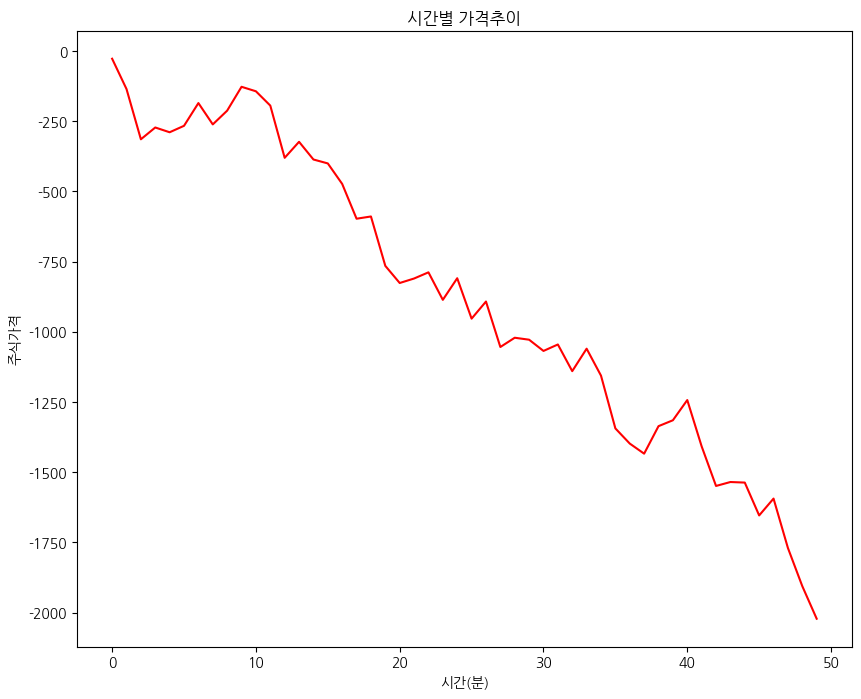

In [ ]:
# 한글을 넣어놓고 그러보면 깨진다
plt.figure(figsize=(10,8))
plt.plot(range(50), data, 'r')
plt.title('시간별 가격추이')
plt.ylabel('주식가격')
plt.xlabel('시간(분)')

서울시의 `상권업종중분류명`에 따른 데이터 개수를 시각화 합니다.

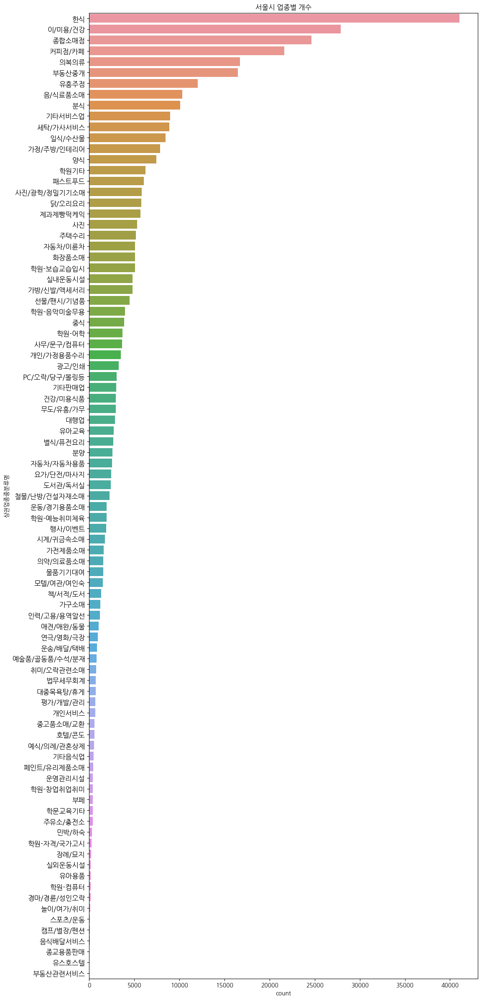

In [ ]:
# 코드입력
plt.figure(figsize=(12, 30))
sns.countplot(y=seoul['상권업종중분류명'], order=seoul['상권업종중분류명'].value_counts().index)
plt.yticks(fontsize=12)
plt.title('서울시 업종별 개수')
plt.show()

**한식 업종이 가장 많은 개수**를 차지합니다. 커피점/카페 업종이 가장 많은 업종일 줄 알았는데요. 한식, 이미용/건강, 종합소매업 다음 4위를 차지하였습니다.

그럼 **커피점/카페** 업종은 자치구별로 **어느 곳에 가장 많이 분포**해 있는지 시각화해 보겠습니다.

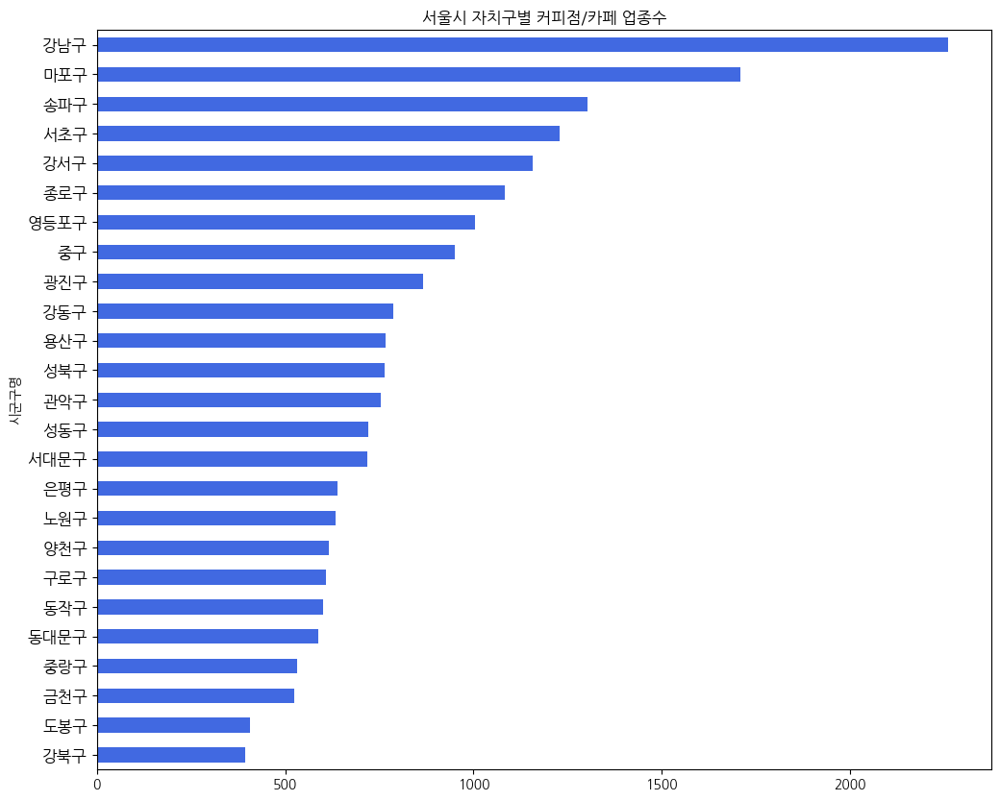

In [ ]:
# 코드입력
plt.figure(figsize=(12, 10))
seoul.loc[seoul['상권업종중분류명'] == '커피점/카페'].groupby('시군구명')['상권업종대분류명'].count()\
                                                     .sort_values().plot(kind='barh', color='royalblue')
plt.yticks(fontsize=12)
plt.title('서울시 자치구별 커피점/카페 업종수')
plt.show()

강남구가 가장 많은 수를 차지하고 강북구는 가장 적은 수를 차지하였습니다.

이제 이를 folium 위에 시각화를 해보겠습니다.

In [ ]:
seoul_coffee = seoul.loc[seoul['상권업종중분류명'] == '커피점/카페']
seoul_coffee

,시군구명,상권업종대분류명,상권업종중분류명,위도,경도
20,종로구,음식,커피점/카페,37.583149,127.000171
96,도봉구,음식,커피점/카페,37.658728,127.034746
189,양천구,음식,커피점/카페,37.522055,126.842935
196,강서구,음식,커피점/카페,37.580941,126.813358
232,강남구,음식,커피점/카페,37.504378,127.054731
...,...,...,...,...,...
377682,서초구,음식,커피점/카페,37.512931,127.010938
377693,마포구,음식,커피점/카페,37.579186,126.892296
377701,강남구,음식,커피점/카페,37.505595,127.049151
377703,강서구,음식,커피점/카페,37.535791,126.846106


In [ ]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=12, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

클러스터를 추가하여 지도위에 시각화 합니다.

In [ ]:
# 코드입력
marker_cluster = MarkerCluster().add_to(m)

for lat, long in zip(seoul_coffee['위도'], seoul_coffee['경도']):
    folium.Marker([lat, long], icon = folium.Icon(color="green")).add_to(marker_cluster)

m

In [ ]:
seoul_group_data = seoul.loc[seoul['상권업종중분류명'] == '커피점/카페'].groupby('시군구명')['상권업종중분류명'].count()
seoul_group_data

시군구명
강남구     2262
강동구      786
강북구      395
강서구     1157
관악구      755
광진구      866
구로구      609
금천구      523
노원구      635
도봉구      407
동대문구     587
동작구      600
마포구     1709
서대문구     719
서초구     1228
성동구      721
성북구      765
송파구     1304
양천구      616
영등포구    1004
용산구      767
은평구      639
종로구     1083
중구       950
중랑구      533
Name: 상권업종중분류명, dtype: int64

`choropleth` 를 사용하여 시각화를 하면 업종 별 개수에 따른 색상의 차이를 두어 시각화를 해줍니다.

In [ ]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

In [ ]:
# 코드입력
m.choropleth(geo_data=seoul_geo,
             data=seoul_group_data, 
             fill_color='YlOrRd', # 색상 변경도 가능하다
             fill_opacity=0.5,
             line_opacity=0.2,
             key_on='properties.name',
             legend_name="지역구별 커피 업종 수"
            )
m

`bins`를 만들어 **1/4, 2/4, 3/4분위수별**로 구간을 나누어 시각화할 수 있습니다.

In [ ]:
# 코드입력
bins = list(seoul_group_data.quantile([0, 0.25, 0.5, 0.75, 1]))

m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m.choropleth(geo_data=seoul_geo,
             data=seoul_group_data, 
             fill_color='YlOrRd', # 색상 변경도 가능하다
             fill_opacity=0.5,
             line_opacity=0.2,
             key_on='properties.name',
             legend_name="지역구별 커피 업종 수", 
             bins=bins
            )
m

## Html 파일로 저장

저장은 `save()` 함수로 쉽게 html 파일로 저장할 수 있습니다.

In [ ]:
# 구글 colab 사용자
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
m.save('map.html')

## 참고 (References)

- [Folium 0.12.1 documentation](https://python-visualization.github.io/folium/)
- [folium을 이용하여 서울시 동별 인구 수 시각화하기](https://d-hyeon.tistory.com/2)
- [지도 핸들링_folium](https://m.blog.naver.com/PostView.naver?isHttpsRedirect=true&blogId=jymoon1115&logNo=221392797679)